In [1]:
import sys
from bing_image_downloader import downloader
import os, shutil
from pathlib import Path


from fastai.vision.all import *
from fastai.vision.widgets import *

/home/studio-lab-user/.conda/envs/fastai/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: libc10_cuda.so: cannot open shared object file: No such file or directory
  warn(f"Failed to load image Python extension: {e}")


In [2]:
dataset_name = 'dogs'
path = Path('../images/' + dataset_name)

In [3]:
#creates the parent dataset folder
if not path.exists():
    path.mkdir()

labels=['husky', 'akita', 'malamute', 'pomeranian']

for l in labels:
    downloader.download(query=f'{l} dog',limit=100,output_dir=path,adult_filter_off=True)

    #changes the folder name from default to fastAI label specific
    if not Path(f"{path}/{l}").exists():
        os.rename(f"{path}/{l} dog", f"{path}/{l}")

    #add code to handle folder management if code is run multiple times 

[%] Downloading Images to /home/studio-lab-user/faststudy/faststudy/notebooks/../images/dogs/husky dog


[!!]Indexing page: 1

[%] Indexed 18 Images on Page 1.


[%] Downloading Image #1 from https://isorepublic.com/wp-content/uploads/2018/11/husky-dog.jpg
[%] File Downloaded !

[%] Downloading Image #2 from https://jooinn.com/images/gray-husky-4.jpg
[%] File Downloaded !

[%] Downloading Image #3 from http://www.mans-best-friend.org.uk/dog-images/husky.jpg
[%] File Downloaded !

[%] Downloading Image #4 from http://giophotography.smugmug.com/Other/Random/Cloud/1221831053_pYr7E-L.jpg
[%] File Downloaded !

[%] Downloading Image #5 from http://1.bp.blogspot.com/-mbVJd5cydrs/VP4b2tJ7emI/AAAAAAAAAGM/LWlCnejinGE/s1600/922818_58996342.jpg
[%] File Downloaded !

[%] Downloading Image #6 from http://thumbs.dreamstime.com/z/husky-dog-23642620.jpg
[%] File Downloaded !

[%] Downloading Image #7 from https://www.breedyourdog.com/uploads/listing_images/35873/102757/big_74B723F9-FD04-4CC0-8AD8-0A9

In [3]:
fns = get_image_files(path)
fns

(#259) [Path('../images/dogs/husky/Image_1.jpg'),Path('../images/dogs/husky/Image_2.jpg'),Path('../images/dogs/husky/Image_3.jpg'),Path('../images/dogs/husky/Image_4.jpg'),Path('../images/dogs/husky/Image_5.jpg'),Path('../images/dogs/husky/Image_6.jpg'),Path('../images/dogs/husky/Image_7.jpeg'),Path('../images/dogs/husky/Image_10.jpg'),Path('../images/dogs/husky/Image_11.png'),Path('../images/dogs/husky/Image_12.jpg')...]

In [4]:
??get_image_files

Signature: get_image_files(path, recurse=True, folders=None)
Source:   
def get_image_files(path, recurse=True, folders=None):
    "Get image files in `path` recursively, only in `folders`, if specified."
    return get_files(path, extensions=image_extensions, recurse=recurse, folders=folders)
File:      ~/.conda/envs/fastai/lib/python3.10/site-packages/fastai/data/transforms.py
Type:      function


In [5]:
failed = verify_images(fns)
failed

(#0) []

In [6]:
failed.map(Path.unlink)

(#0) []

In [7]:
datablock = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=0),
    get_y=parent_label,
    item_tfms=Resize(128),
    batch_tfms=aug_transforms(mult=2))

In [8]:
dls = datablock.dataloaders(path)

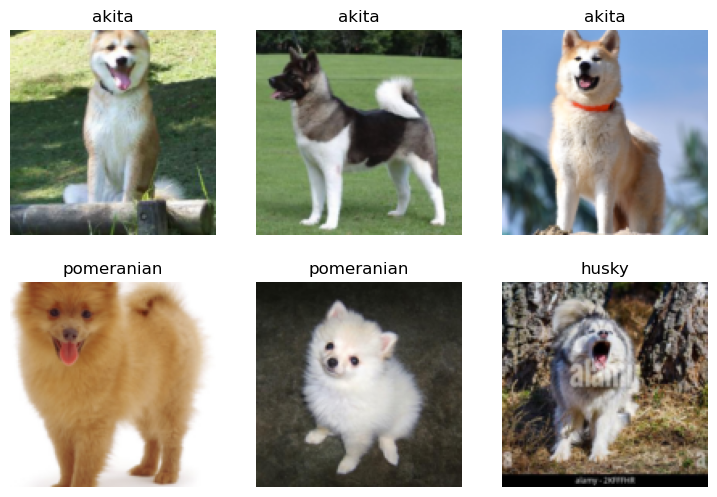

In [9]:
dls.valid.show_batch(max_n=6, nrows=2)

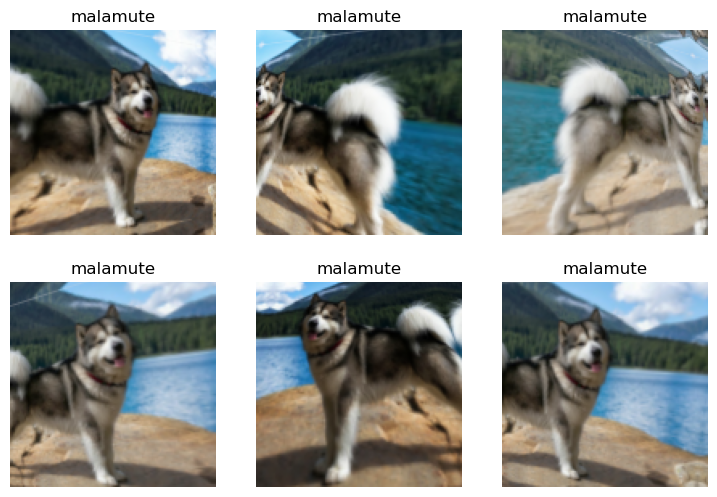

In [10]:
dls.train.show_batch(max_n=6, nrows=2, unique=True)

In [12]:
learn = vision_learner(dls, resnet18, metrics=error_rate)

In [15]:
learn.fine_tune(50)

epoch,train_loss,valid_loss,error_rate,time
0,0.857291,1.184401,0.294118,00:10


epoch,train_loss,valid_loss,error_rate,time
0,0.844195,1.196045,0.294118,00:10
1,0.762364,1.205769,0.313725,00:10
2,0.744626,1.220315,0.313725,00:10
3,0.714319,1.210593,0.294118,00:10
4,0.678569,1.205848,0.274510,00:10
5,0.627821,1.190865,0.274510,00:10
6,0.608523,1.211496,0.294118,00:10
7,0.600973,1.250799,0.294118,00:10
8,0.573556,1.294742,0.294118,00:10
9,0.544606,1.344629,0.294118,00:10


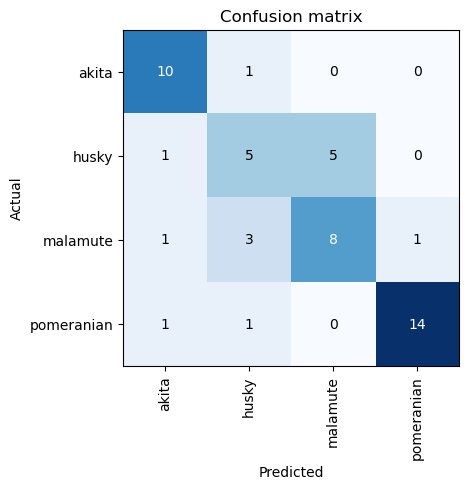

In [16]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

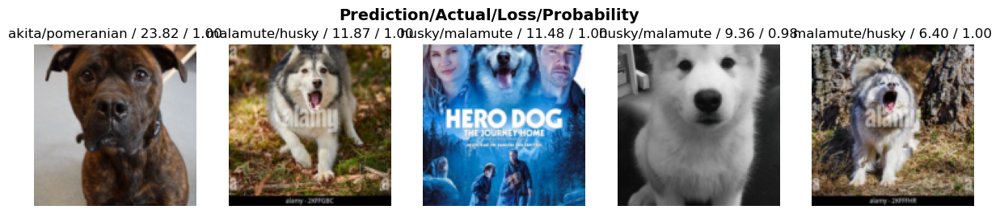

In [17]:
interp.plot_top_losses(5, nrows=1)

In [20]:
learn.export("../models/dogs_resnet18.pkl")

Bellow checking images

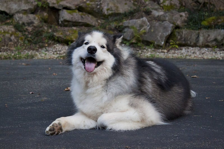

../images/dogs/malamute/Image_1.jpg


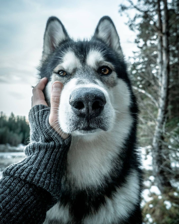

../images/dogs/malamute/Image_2.jpg


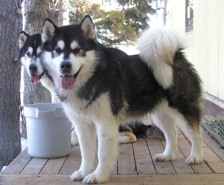

../images/dogs/malamute/Image_3.jpg


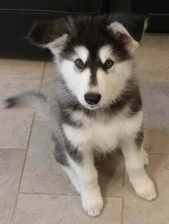

../images/dogs/malamute/Image_4.jpg


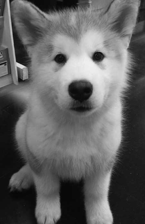

../images/dogs/malamute/Image_5.jpg


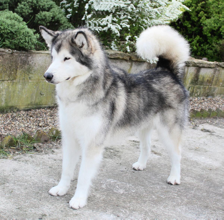

../images/dogs/malamute/Image_6.jpg


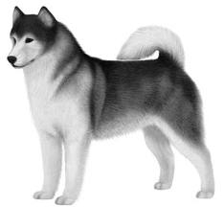

../images/dogs/malamute/Image_7.jpeg


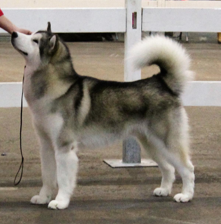

../images/dogs/malamute/Image_8.jpg


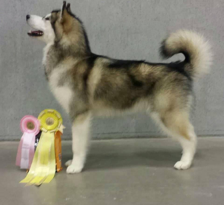

../images/dogs/malamute/Image_9.jpg


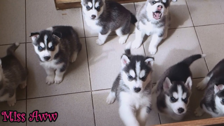

../images/dogs/malamute/Image_10.jpg


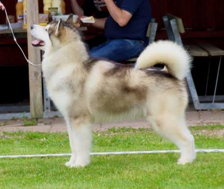

../images/dogs/malamute/Image_11.jpg


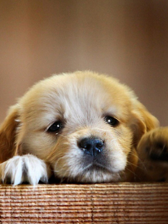

../images/dogs/malamute/Image_12.jpg


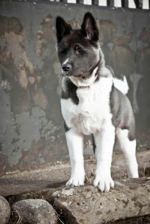

../images/dogs/malamute/Image_15.jpg


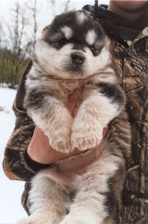

../images/dogs/malamute/Image_16.jpg


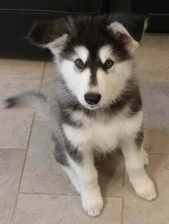

../images/dogs/malamute/Image_17.jpg


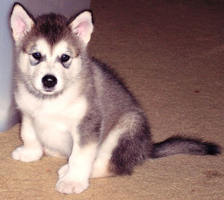

../images/dogs/malamute/Image_18.jpg


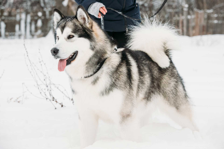

../images/dogs/malamute/Image_19.jpg


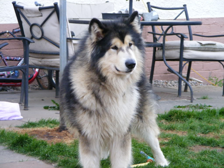

../images/dogs/malamute/Image_20.jpg


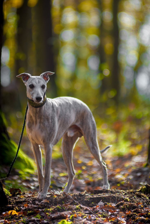

../images/dogs/malamute/Image_22.jpg


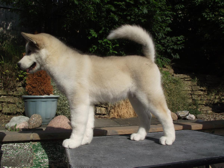

../images/dogs/malamute/Image_23.jpg


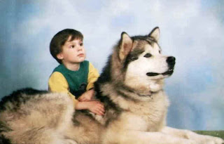

../images/dogs/malamute/Image_24.jpg


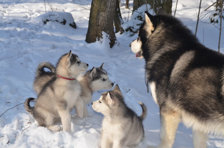

../images/dogs/malamute/Image_25.jpg


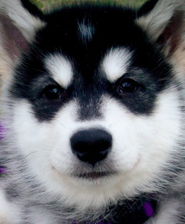

../images/dogs/malamute/Image_26.jpg


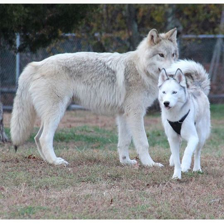

../images/dogs/malamute/Image_27.jpg


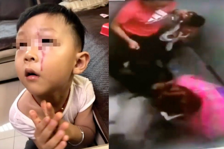

../images/dogs/malamute/Image_28.jpg


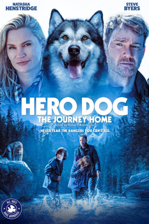

../images/dogs/malamute/Image_29.jpg


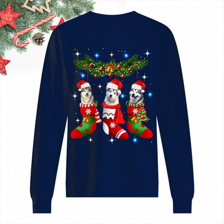

../images/dogs/malamute/Image_30.png


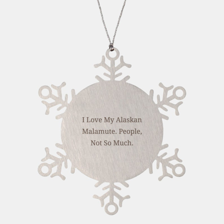

../images/dogs/malamute/Image_31.jpg


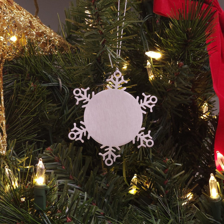

../images/dogs/malamute/Image_32.jpg


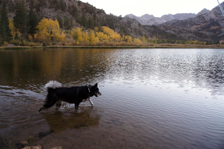

../images/dogs/malamute/Image_33.jpg


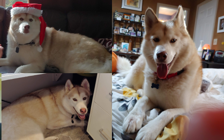

../images/dogs/malamute/Image_34.png


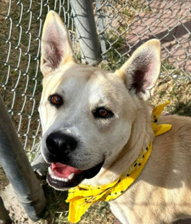

../images/dogs/malamute/Image_35.jpeg


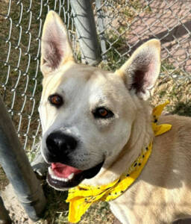

../images/dogs/malamute/Image_36.jpeg


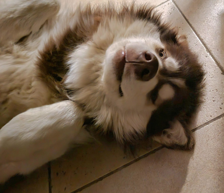

../images/dogs/malamute/Image_37.jpg


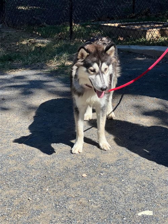

../images/dogs/malamute/Image_38.jpg


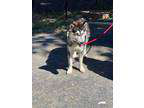

../images/dogs/malamute/Image_39.jpg


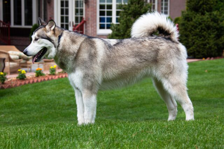

../images/dogs/malamute/Image_40.jpg


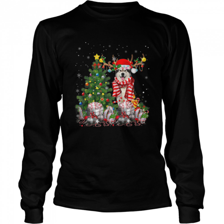

../images/dogs/malamute/Image_41.jpg


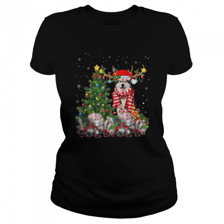

../images/dogs/malamute/Image_42.jpg


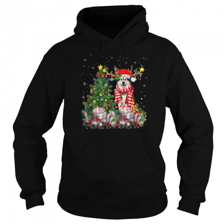

../images/dogs/malamute/Image_43.jpg


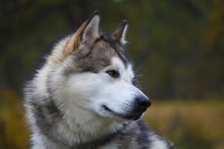

../images/dogs/malamute/Image_44.jpeg


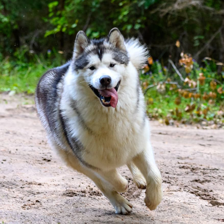

../images/dogs/malamute/Image_45.jpg


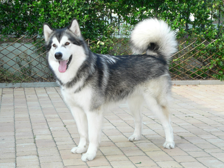

../images/dogs/malamute/Image_46.jpg


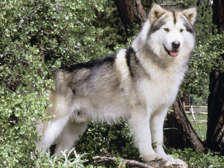

../images/dogs/malamute/Image_47.jpg


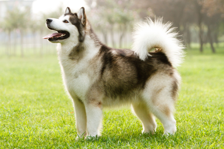

../images/dogs/malamute/Image_48.jpg


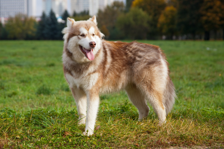

../images/dogs/malamute/Image_49.jpg


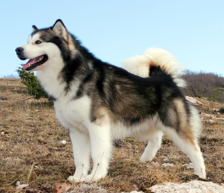

../images/dogs/malamute/Image_50.jpg


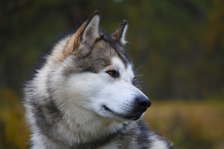

../images/dogs/malamute/Image_51.jpg


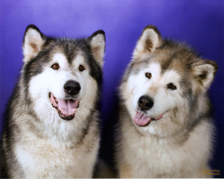

../images/dogs/malamute/Image_52.jpg


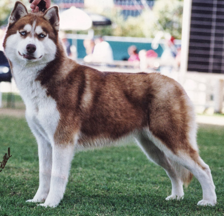

../images/dogs/malamute/Image_53.jpg


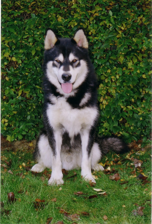

../images/dogs/malamute/Image_54.jpg


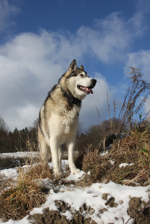

../images/dogs/malamute/Image_55.jpg


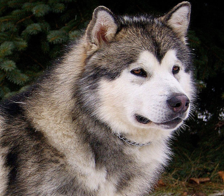

../images/dogs/malamute/Image_56.jpg


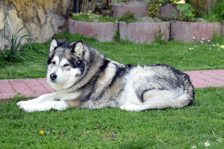

../images/dogs/malamute/Image_57.jpg


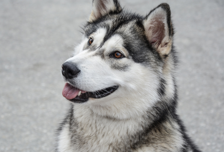

../images/dogs/malamute/Image_58.jpg


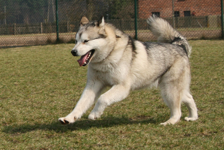

../images/dogs/malamute/Image_59.jpg


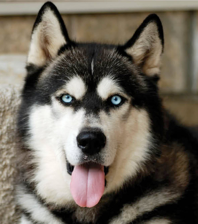

../images/dogs/malamute/Image_60.jpg


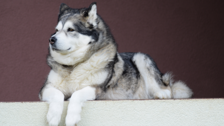

../images/dogs/malamute/Image_61.jpg


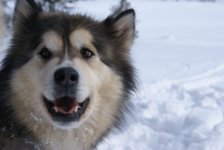

../images/dogs/malamute/Image_62.jpg


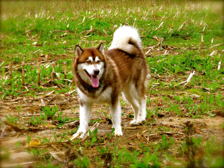

../images/dogs/malamute/Image_63.jpg


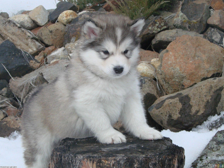

../images/dogs/malamute/Image_64.jpg


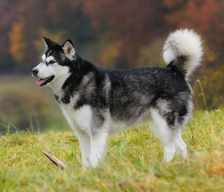

../images/dogs/malamute/Image_65.png


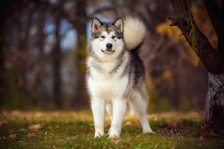

../images/dogs/malamute/Image_66.jpg


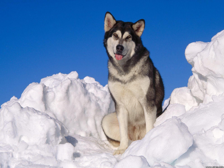

../images/dogs/malamute/Image_67.jpg


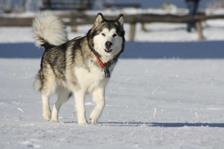

../images/dogs/malamute/Image_68.jpg


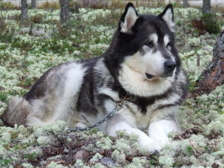

../images/dogs/malamute/Image_69.jpg


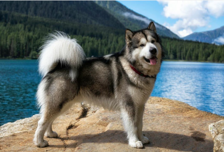

../images/dogs/malamute/Image_70.png


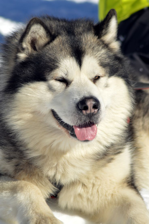

../images/dogs/malamute/Image_71.jpg


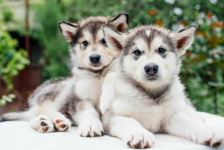

../images/dogs/malamute/Image_72.jpg


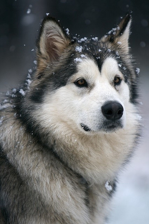

../images/dogs/malamute/Image_73.jpg


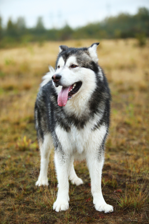

../images/dogs/malamute/Image_74.jpg


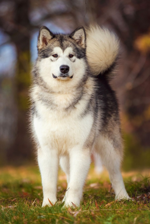

../images/dogs/malamute/Image_75.jpg


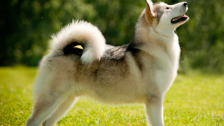

../images/dogs/malamute/Image_76.jpg


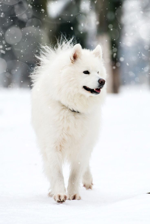

../images/dogs/malamute/Image_77.jpg


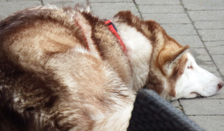

../images/dogs/malamute/Image_78.JPG


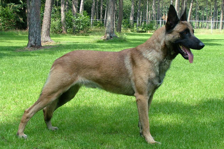

../images/dogs/malamute/Image_79.jpg


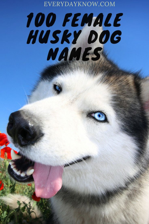

../images/dogs/malamute/Image_80.jpg


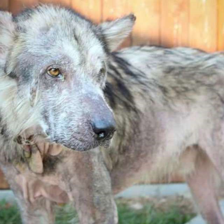

../images/dogs/malamute/Image_81.jpg


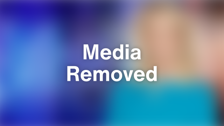

../images/dogs/malamute/Image_82.jpg


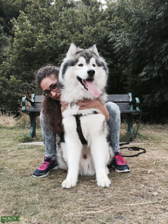

../images/dogs/malamute/Image_83.jpeg


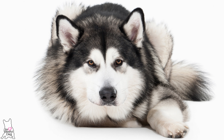

../images/dogs/malamute/Image_84.jpg


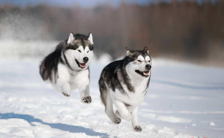

../images/dogs/malamute/Image_85.jpg


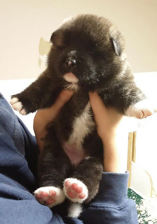

../images/dogs/malamute/Image_86.jpg


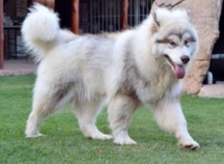

../images/dogs/malamute/Image_87.jpg


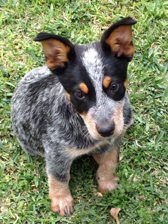

../images/dogs/malamute/Image_88.jpg


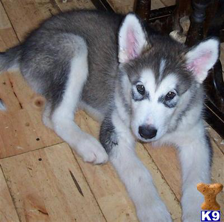

../images/dogs/malamute/Image_89.jpg


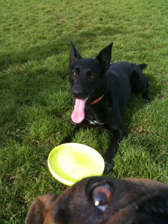

../images/dogs/malamute/Image_90.jpg


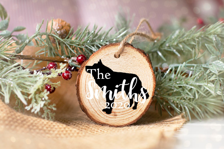

../images/dogs/malamute/Image_91.jpg


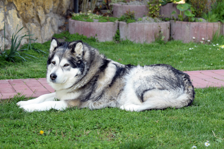

../images/dogs/malamute/Image_92.jpg


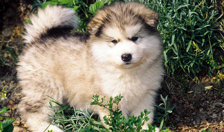

../images/dogs/malamute/Image_93.jpg


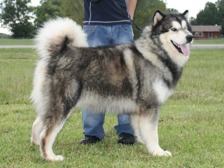

../images/dogs/malamute/Image_94.jpg


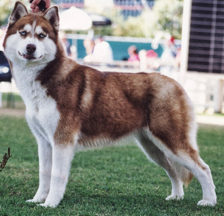

../images/dogs/malamute/Image_95.jpg


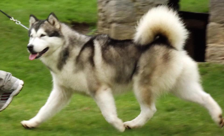

../images/dogs/malamute/Image_96.jpg


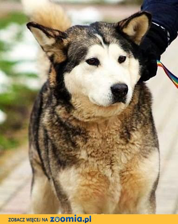

../images/dogs/malamute/Image_97.jpg


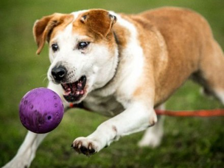

../images/dogs/malamute/Image_98.jpg


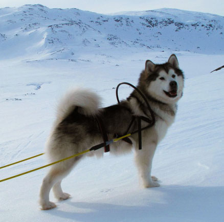

../images/dogs/malamute/Image_99.jpg


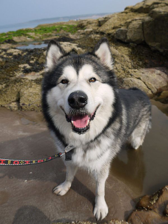

../images/dogs/malamute/Image_100.jpg


In [36]:
malamutes = get_image_files(Path(f'{path}/malamute'))

for dog in malamutes:
    print("=======")
    PILImage.create(dog).to_thumb(h=224).show()
    print(dog)
    print("=======")

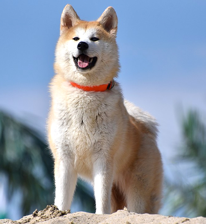

../images/dogs/akita/Image_1.jpg


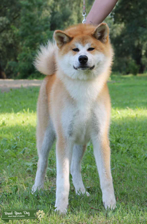

../images/dogs/akita/Image_2.jpg


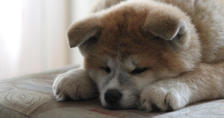

../images/dogs/akita/Image_3.jpg


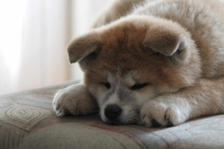

../images/dogs/akita/Image_4.jpg


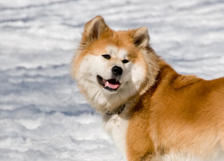

../images/dogs/akita/Image_5.jpg


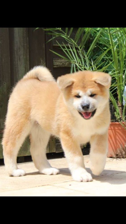

../images/dogs/akita/Image_6.jpg


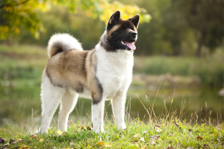

../images/dogs/akita/Image_7.jpg


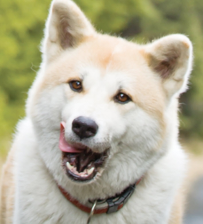

../images/dogs/akita/Image_8.jpg


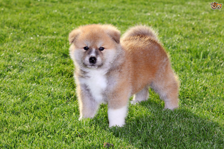

../images/dogs/akita/Image_9.jpg


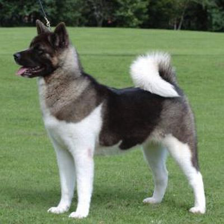

../images/dogs/akita/Image_10.jpg


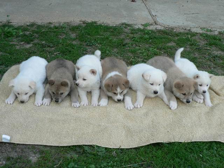

../images/dogs/akita/Image_11.jpg


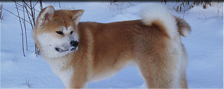

../images/dogs/akita/Image_12.jpg


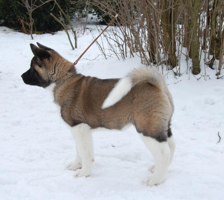

../images/dogs/akita/Image_13.jpg


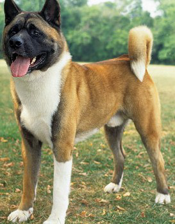

../images/dogs/akita/Image_14.jpg


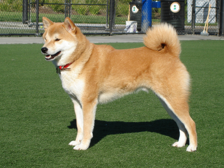

../images/dogs/akita/Image_18.jpg


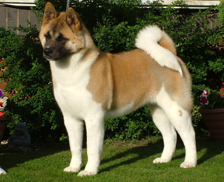

../images/dogs/akita/Image_19.jpg


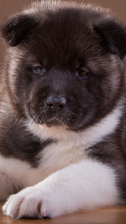

../images/dogs/akita/Image_20.jpg


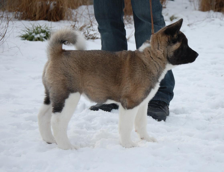

../images/dogs/akita/Image_21.jpg


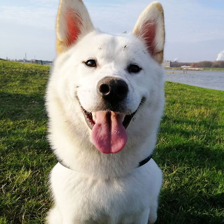

../images/dogs/akita/Image_22.jpg


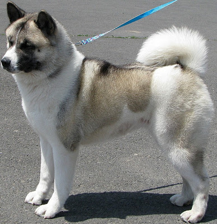

../images/dogs/akita/Image_23.jpg


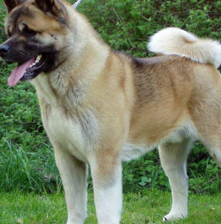

../images/dogs/akita/Image_24.jpg


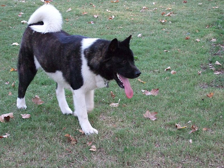

../images/dogs/akita/Image_25.jpg


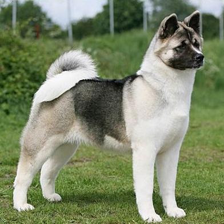

../images/dogs/akita/Image_26.jpg


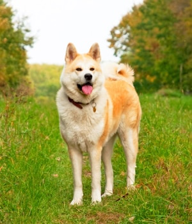

../images/dogs/akita/Image_27.jpg


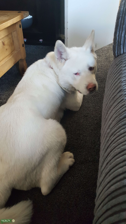

../images/dogs/akita/Image_28.jpg


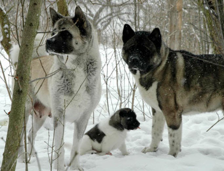

../images/dogs/akita/Image_29.jpg


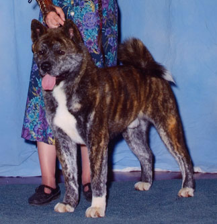

../images/dogs/akita/Image_30.jpg


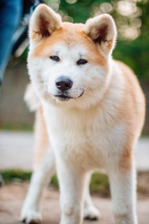

../images/dogs/akita/Image_31.jpg


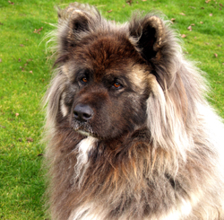

../images/dogs/akita/Image_32.jpg


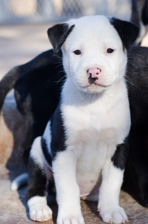

../images/dogs/akita/Image_33.jpg


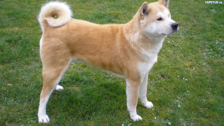

../images/dogs/akita/Image_34.jpg


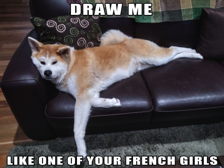

../images/dogs/akita/Image_35.jpg


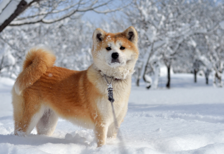

../images/dogs/akita/Image_36.jpg


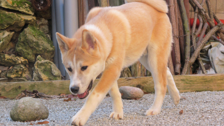

../images/dogs/akita/Image_37.jpg


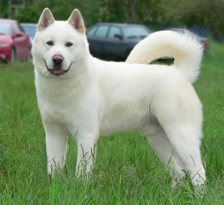

../images/dogs/akita/Image_38.jpg


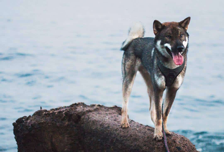

../images/dogs/akita/Image_39.jpg


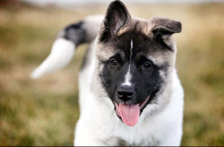

../images/dogs/akita/Image_40.jpg


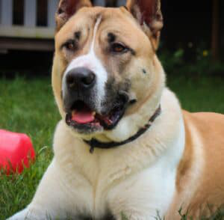

../images/dogs/akita/Image_41.jpg


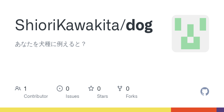

../images/dogs/akita/Image_42.jpg


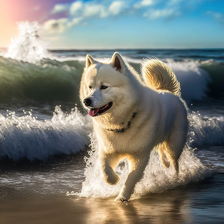

../images/dogs/akita/Image_43.jpg


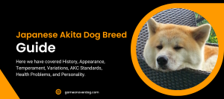

../images/dogs/akita/Image_44.png


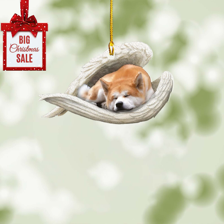

../images/dogs/akita/Image_45.jpg


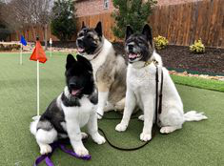

../images/dogs/akita/Image_46.jpg


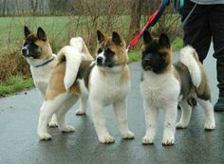

../images/dogs/akita/Image_47.jpg


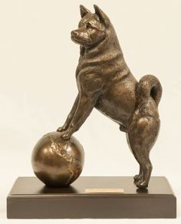

../images/dogs/akita/Image_48.jpg


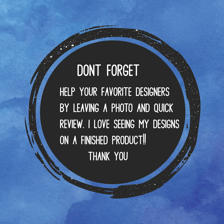

../images/dogs/akita/Image_49.jpg


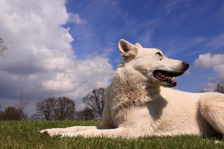

../images/dogs/akita/Image_50.jpg


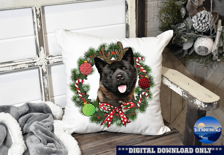

../images/dogs/akita/Image_51.jpg


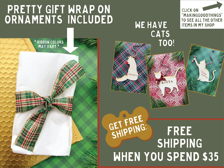

../images/dogs/akita/Image_52.jpg


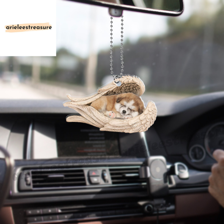

../images/dogs/akita/Image_53.jpg


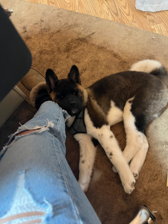

../images/dogs/akita/Image_54.jpg


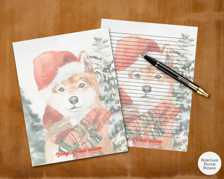

../images/dogs/akita/Image_55.jpg


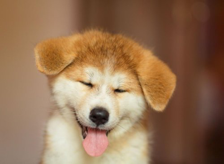

../images/dogs/akita/Image_56.jpeg


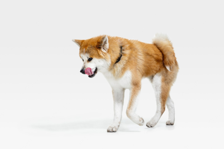

../images/dogs/akita/Image_57.jpg


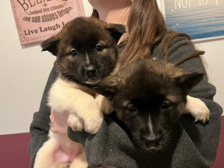

../images/dogs/akita/Image_58.jpg


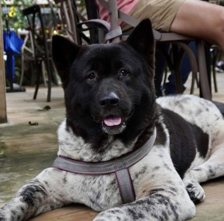

../images/dogs/akita/Image_59.jpg


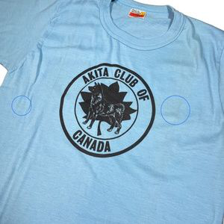

../images/dogs/akita/Image_60.jpeg


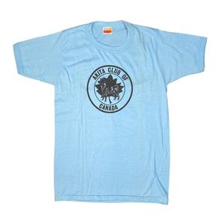

../images/dogs/akita/Image_61.jpeg


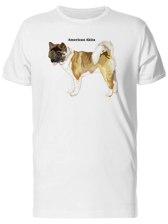

../images/dogs/akita/Image_62.jpeg


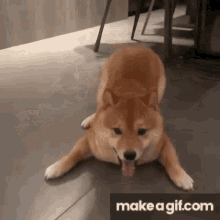

../images/dogs/akita/Image_63.gif


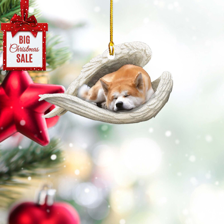

../images/dogs/akita/Image_64.jpg


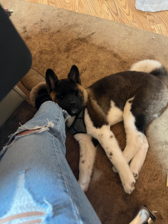

../images/dogs/akita/Image_65.jpg


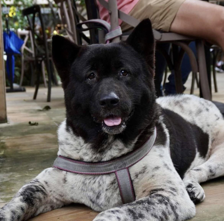

../images/dogs/akita/Image_66.jpg


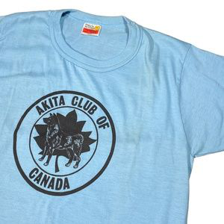

../images/dogs/akita/Image_67.jpeg


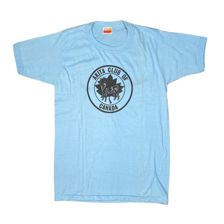

../images/dogs/akita/Image_68.jpeg


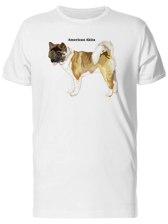

../images/dogs/akita/Image_69.jpeg


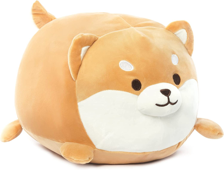

../images/dogs/akita/Image_70.jpeg


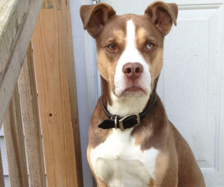

../images/dogs/akita/Image_71.jpg


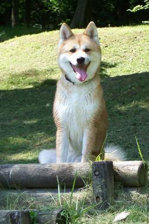

../images/dogs/akita/Image_72.jpg


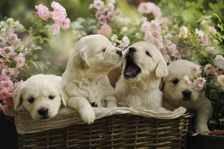

../images/dogs/akita/Image_73.jpg


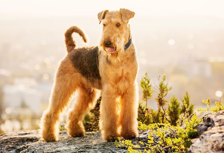

../images/dogs/akita/Image_74.jpg


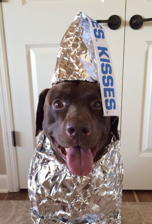

../images/dogs/akita/Image_75.jpg


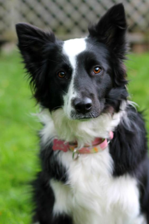

../images/dogs/akita/Image_76.jpg


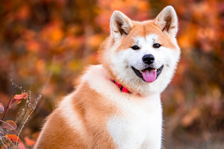

../images/dogs/akita/Image_77.jpg


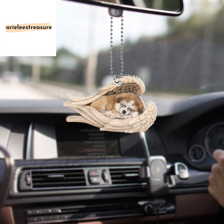

../images/dogs/akita/Image_78.jpg


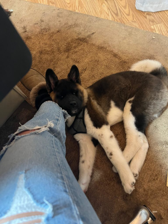

../images/dogs/akita/Image_79.jpg


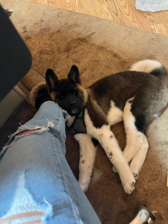

../images/dogs/akita/Image_80.jpg


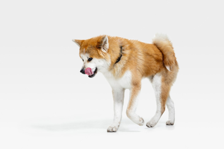

../images/dogs/akita/Image_81.jpg


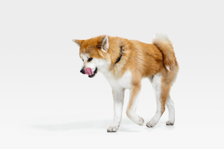

../images/dogs/akita/Image_82.jpg


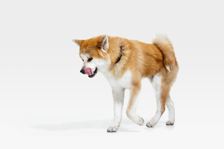

../images/dogs/akita/Image_83.jpg


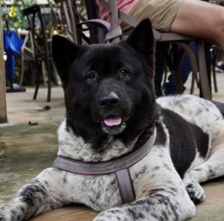

../images/dogs/akita/Image_84.jpg


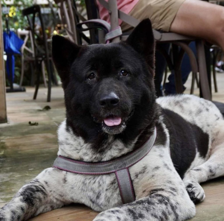

../images/dogs/akita/Image_85.jpg


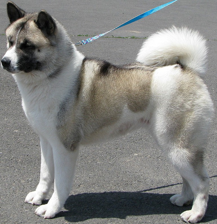

../images/dogs/akita/Image_86.jpg


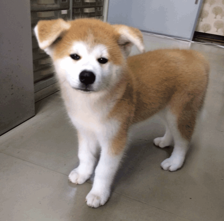

../images/dogs/akita/Image_87.png


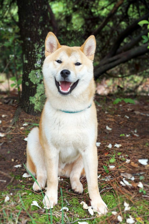

../images/dogs/akita/Image_88.jpg


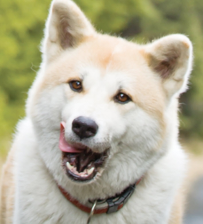

../images/dogs/akita/Image_89.jpg


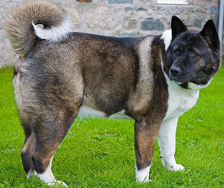

../images/dogs/akita/Image_90.jpg


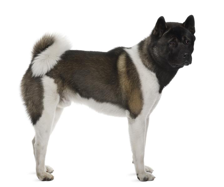

../images/dogs/akita/Image_91.jpg


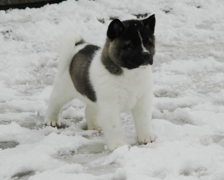

../images/dogs/akita/Image_92.jpg


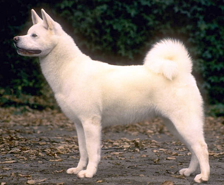

../images/dogs/akita/Image_93.jpg


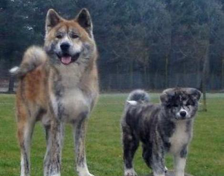

../images/dogs/akita/Image_94.jpg


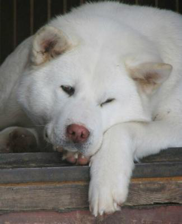

../images/dogs/akita/Image_95.jpg


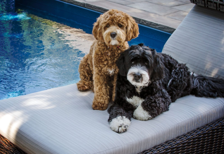

../images/dogs/akita/Image_96.jpg


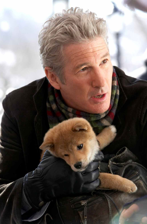

../images/dogs/akita/Image_97.jpg


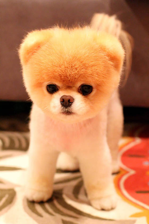

../images/dogs/akita/Image_98.jpg


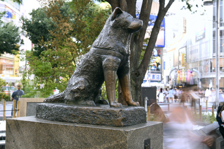

../images/dogs/akita/Image_99.jpg


In [37]:
akita = get_image_files(Path(f'{path}/akita'))

for dog in akita:
    print("=======")
    PILImage.create(dog).to_thumb(h=224).show()
    print(dog)
    print("=======")

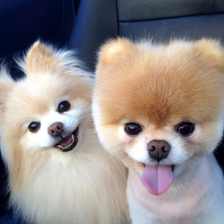

../images/dogs/pomeranian/Image_1.jpg


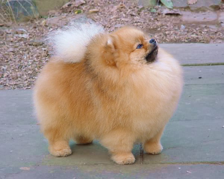

../images/dogs/pomeranian/Image_2.jpg


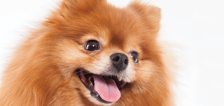

../images/dogs/pomeranian/Image_3.jpg


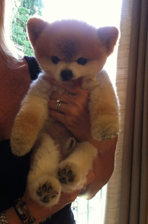

../images/dogs/pomeranian/Image_4.jpg


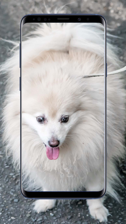

../images/dogs/pomeranian/Image_5.jpg


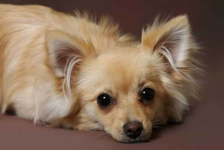

../images/dogs/pomeranian/Image_6.jpg


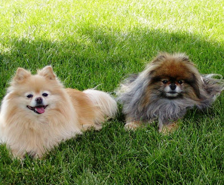

../images/dogs/pomeranian/Image_7.jpg


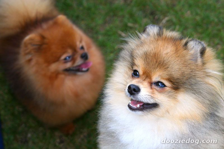

../images/dogs/pomeranian/Image_8.jpg


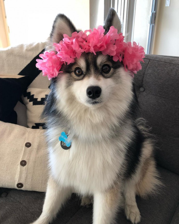

../images/dogs/pomeranian/Image_9.jpg


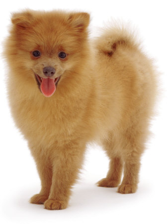

../images/dogs/pomeranian/Image_10.jpg


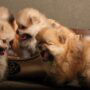

../images/dogs/pomeranian/Image_11.jpg


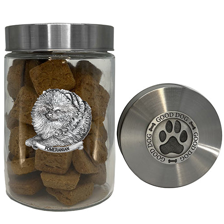

../images/dogs/pomeranian/Image_12.jpg


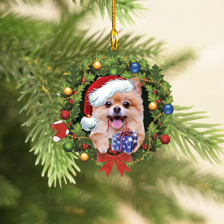

../images/dogs/pomeranian/Image_13.jpg


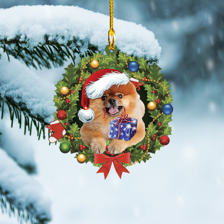

../images/dogs/pomeranian/Image_14.jpg


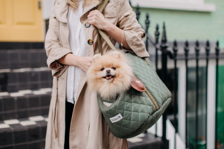

../images/dogs/pomeranian/Image_15.jpg


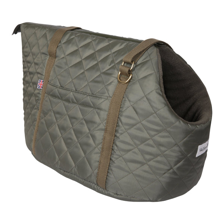

../images/dogs/pomeranian/Image_16.jpg


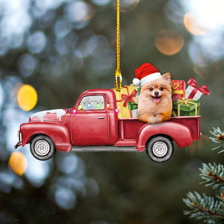

../images/dogs/pomeranian/Image_17.jpg


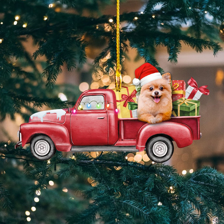

../images/dogs/pomeranian/Image_18.jpg


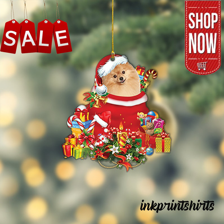

../images/dogs/pomeranian/Image_19.jpg


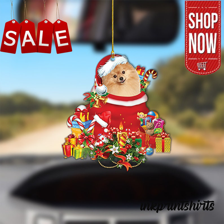

../images/dogs/pomeranian/Image_20.jpg


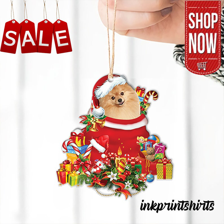

../images/dogs/pomeranian/Image_21.jpg


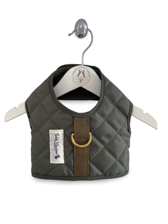

../images/dogs/pomeranian/Image_22.jpg


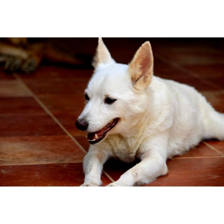

../images/dogs/pomeranian/Image_23.jpg


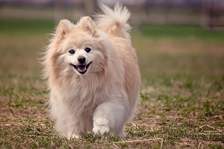

../images/dogs/pomeranian/Image_24.jpg


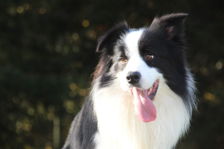

../images/dogs/pomeranian/Image_25.jpg


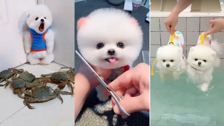

../images/dogs/pomeranian/Image_26.jpg


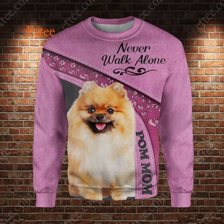

../images/dogs/pomeranian/Image_27.jpg


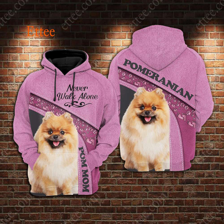

../images/dogs/pomeranian/Image_28.jpg


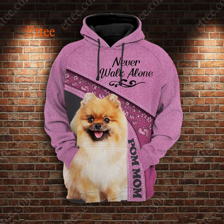

../images/dogs/pomeranian/Image_29.jpg


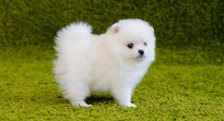

../images/dogs/pomeranian/Image_30.jpg


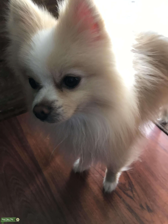

../images/dogs/pomeranian/Image_31.jpeg


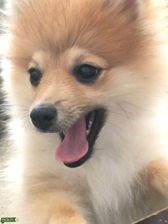

../images/dogs/pomeranian/Image_32.jpeg


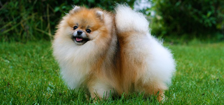

../images/dogs/pomeranian/Image_33.jpg


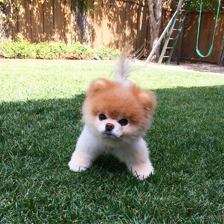

../images/dogs/pomeranian/Image_34.jpg


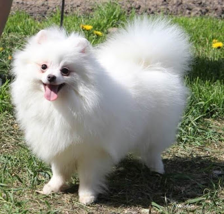

../images/dogs/pomeranian/Image_35.jpg


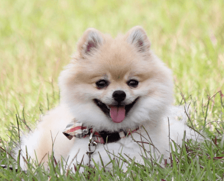

../images/dogs/pomeranian/Image_36.png


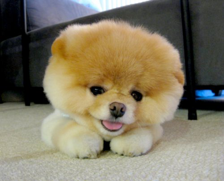

../images/dogs/pomeranian/Image_37.jpg


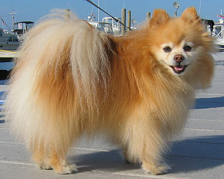

../images/dogs/pomeranian/Image_38.jpg


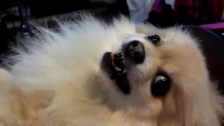

../images/dogs/pomeranian/Image_39.jpg


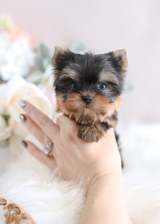

../images/dogs/pomeranian/Image_40.jpg


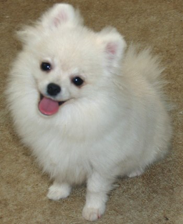

../images/dogs/pomeranian/Image_41.jpg


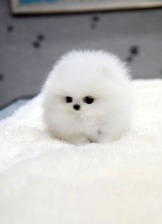

../images/dogs/pomeranian/Image_42.jpg


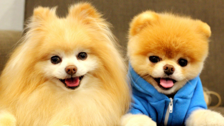

../images/dogs/pomeranian/Image_43.jpg


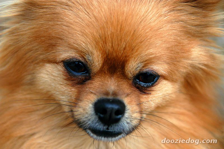

../images/dogs/pomeranian/Image_44.jpg


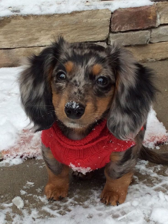

../images/dogs/pomeranian/Image_45.jpg


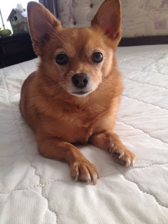

../images/dogs/pomeranian/Image_46.jpg


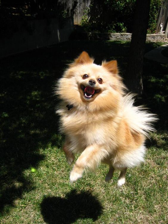

../images/dogs/pomeranian/Image_47.jpg


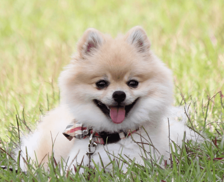

../images/dogs/pomeranian/Image_48.png


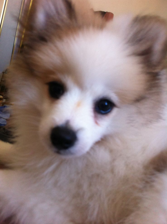

../images/dogs/pomeranian/Image_49.jpg


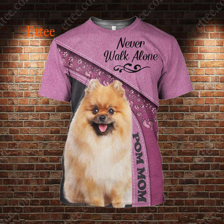

../images/dogs/pomeranian/Image_50.jpg


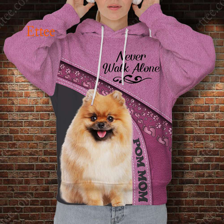

../images/dogs/pomeranian/Image_51.jpg


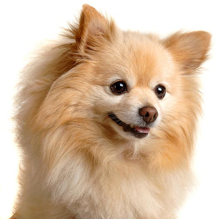

../images/dogs/pomeranian/Image_52.jpg


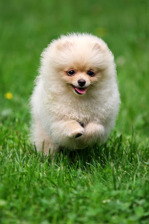

../images/dogs/pomeranian/Image_53.jpg


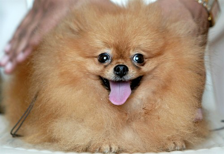

../images/dogs/pomeranian/Image_54.jpg


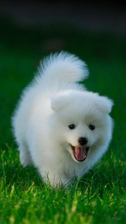

../images/dogs/pomeranian/Image_55.jpg


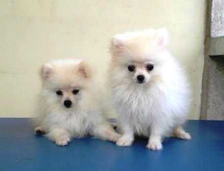

../images/dogs/pomeranian/Image_56.jpg


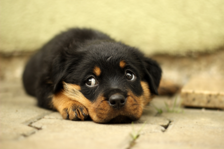

../images/dogs/pomeranian/Image_57.jpg


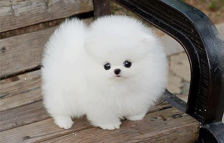

../images/dogs/pomeranian/Image_58.jpg


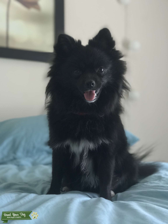

../images/dogs/pomeranian/Image_59.jpeg


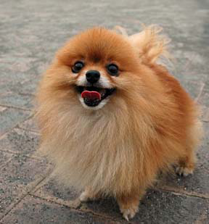

../images/dogs/pomeranian/Image_60.jpg


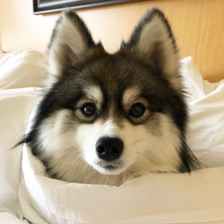

../images/dogs/pomeranian/Image_61.jpg


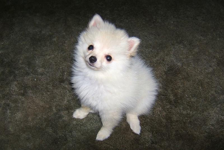

../images/dogs/pomeranian/Image_62.jpg


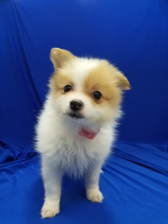

../images/dogs/pomeranian/Image_63.jpg


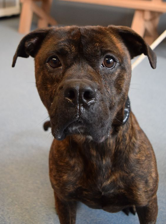

../images/dogs/pomeranian/Image_64.jpg


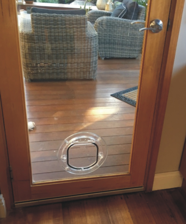

../images/dogs/pomeranian/Image_65.jpg


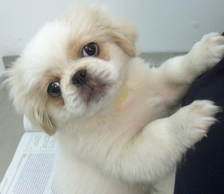

../images/dogs/pomeranian/Image_66.jpg


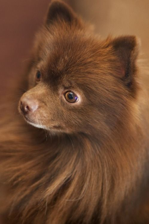

../images/dogs/pomeranian/Image_67.jpg


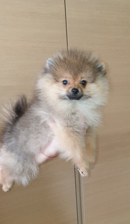

../images/dogs/pomeranian/Image_68.jpg


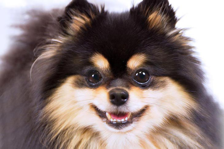

../images/dogs/pomeranian/Image_69.jpg


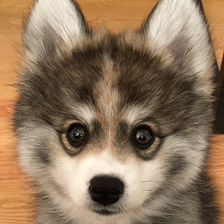

../images/dogs/pomeranian/Image_70.jpg


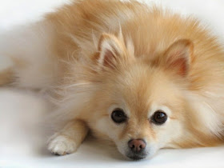

../images/dogs/pomeranian/Image_71.jpg


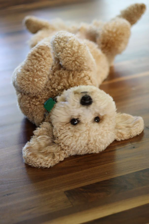

../images/dogs/pomeranian/Image_72.jpg


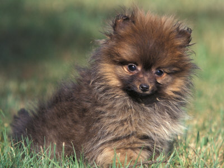

../images/dogs/pomeranian/Image_73.jpg


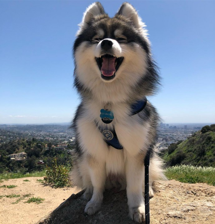

../images/dogs/pomeranian/Image_74.jpg


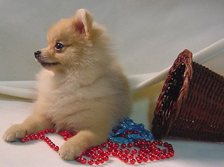

../images/dogs/pomeranian/Image_75.jpg


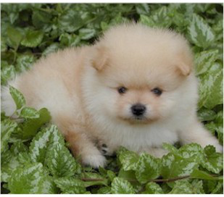

../images/dogs/pomeranian/Image_76.jpg


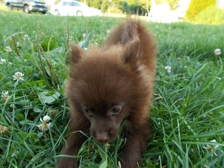

../images/dogs/pomeranian/Image_77.jpg


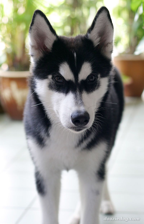

../images/dogs/pomeranian/Image_78.jpg


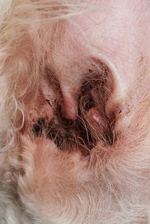

../images/dogs/pomeranian/Image_79.jpg


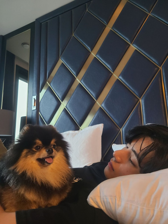

../images/dogs/pomeranian/Image_80.jpg


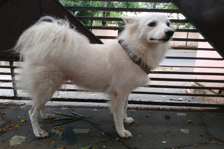

../images/dogs/pomeranian/Image_81.jpg


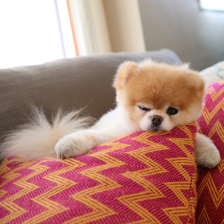

../images/dogs/pomeranian/Image_82.jpg


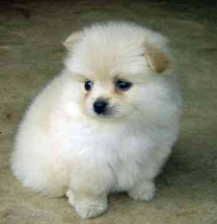

../images/dogs/pomeranian/Image_83.jpg


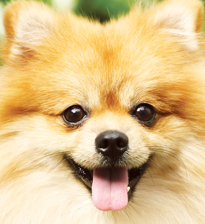

../images/dogs/pomeranian/Image_84.jpg


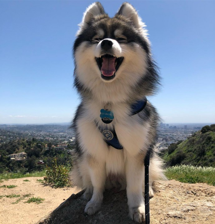

../images/dogs/pomeranian/Image_85.jpg


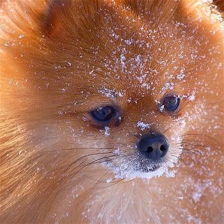

../images/dogs/pomeranian/Image_86.jpg


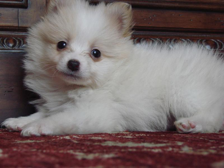

../images/dogs/pomeranian/Image_87.jpg


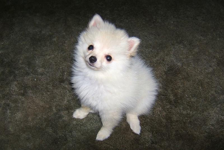

../images/dogs/pomeranian/Image_88.jpg


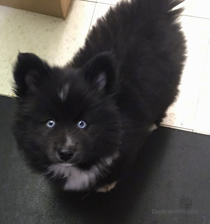

../images/dogs/pomeranian/Image_89.jpg


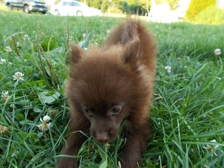

../images/dogs/pomeranian/Image_90.jpg


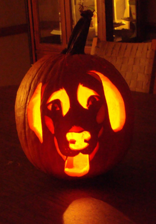

../images/dogs/pomeranian/Image_91.jpg


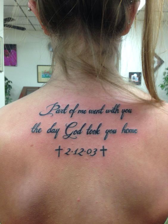

../images/dogs/pomeranian/Image_92.jpg


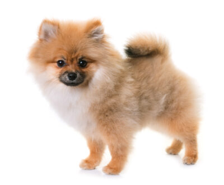

../images/dogs/pomeranian/Image_93.jpg


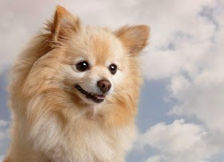

../images/dogs/pomeranian/Image_94.jpg


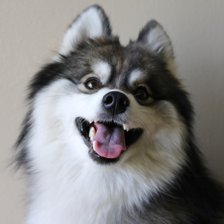

../images/dogs/pomeranian/Image_95.jpg


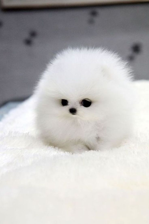

../images/dogs/pomeranian/Image_96.jpg


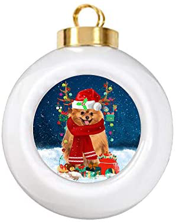

../images/dogs/pomeranian/Image_97.jpg


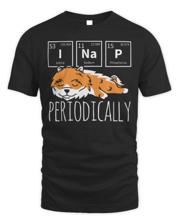

../images/dogs/pomeranian/Image_98.jpg


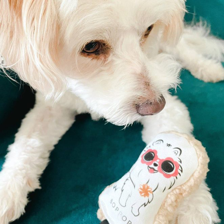

../images/dogs/pomeranian/Image_99.jpeg


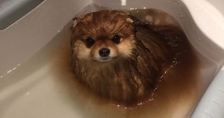

../images/dogs/pomeranian/Image_100.jpeg


In [46]:
pomeranian = get_image_files(Path(f'{path}/pomeranian'))

for dog in pomeranian:
    print("=======")
    PILImage.create(dog).to_thumb(h=224).show()
    print(dog)
    print("=======")

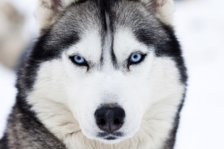

../images/dogs/husky/Image_1.jpg


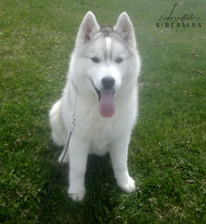

../images/dogs/husky/Image_2.jpg


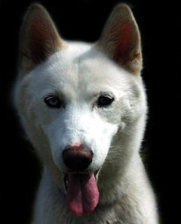

../images/dogs/husky/Image_3.jpg


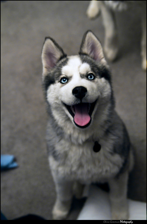

../images/dogs/husky/Image_4.jpg


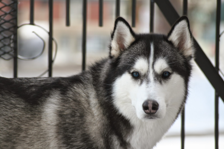

../images/dogs/husky/Image_5.jpg


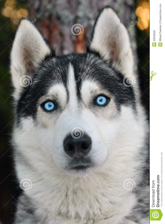

../images/dogs/husky/Image_6.jpg


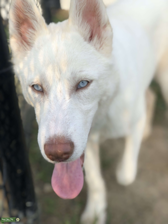

../images/dogs/husky/Image_7.jpeg


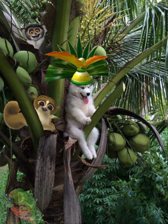

../images/dogs/husky/Image_8.jpg


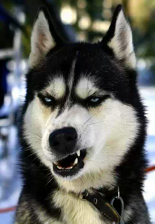

../images/dogs/husky/Image_9.jpg


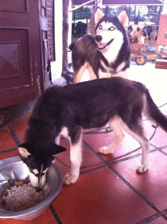

../images/dogs/husky/Image_10.jpg


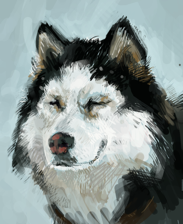

../images/dogs/husky/Image_11.png


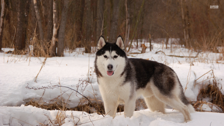

../images/dogs/husky/Image_12.jpg


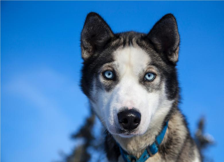

../images/dogs/husky/Image_13.jpg


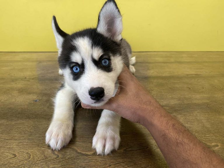

../images/dogs/husky/Image_14.jpg


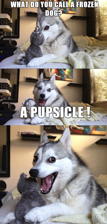

../images/dogs/husky/Image_15.jpg


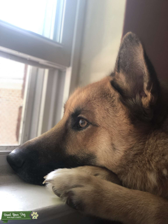

../images/dogs/husky/Image_16.jpeg


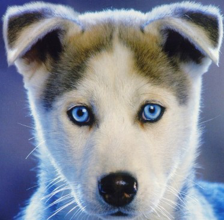

../images/dogs/husky/Image_17.jpg


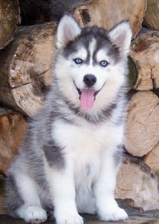

../images/dogs/husky/Image_18.jpg


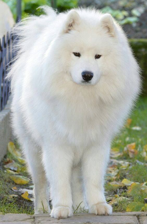

../images/dogs/husky/Image_19.jpg


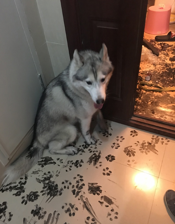

../images/dogs/husky/Image_20.jpg


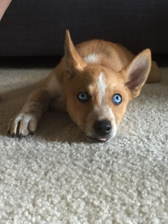

../images/dogs/husky/Image_21.jpg


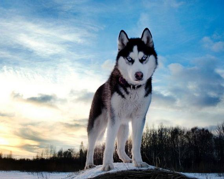

../images/dogs/husky/Image_22.jpg


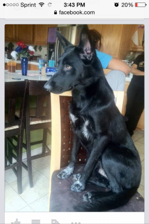

../images/dogs/husky/Image_23.jpg


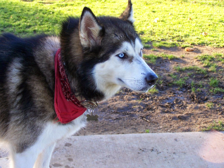

../images/dogs/husky/Image_24.jpg


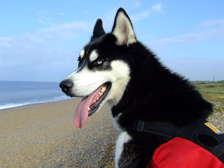

../images/dogs/husky/Image_25.jpg


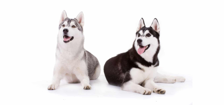

../images/dogs/husky/Image_26.jpg


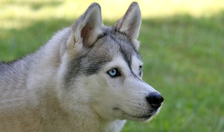

../images/dogs/husky/Image_27.jpg


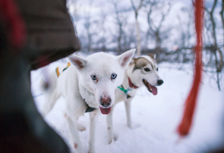

../images/dogs/husky/Image_28.jpg


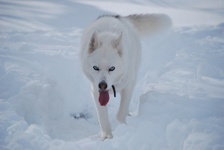

../images/dogs/husky/Image_29.jpg


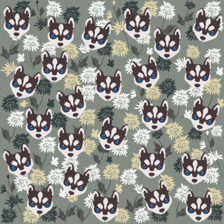

../images/dogs/husky/Image_30.jpg


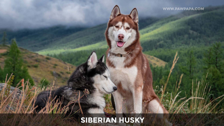

../images/dogs/husky/Image_31.jpg


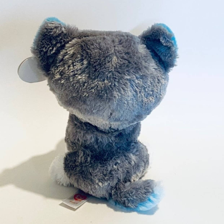

../images/dogs/husky/Image_32.jpeg


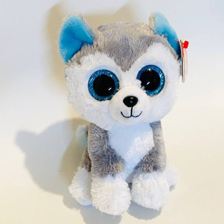

../images/dogs/husky/Image_33.jpeg


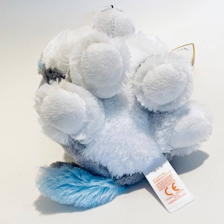

../images/dogs/husky/Image_34.jpeg


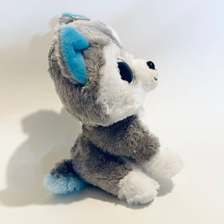

../images/dogs/husky/Image_35.jpeg


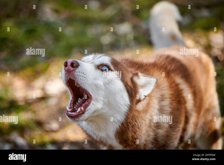

../images/dogs/husky/Image_36.jpg


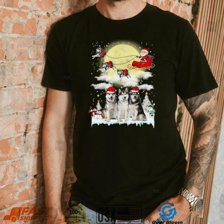

../images/dogs/husky/Image_37.jpg


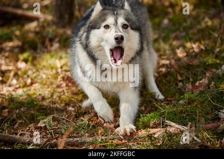

../images/dogs/husky/Image_38.jpg


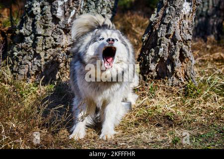

../images/dogs/husky/Image_39.jpg


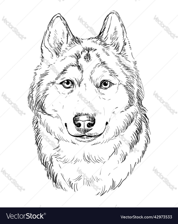

../images/dogs/husky/Image_40.jpg


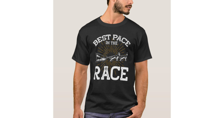

../images/dogs/husky/Image_41.jpg


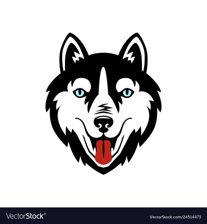

../images/dogs/husky/Image_42.jpg


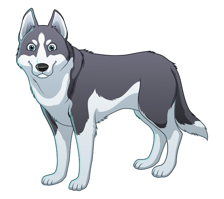

../images/dogs/husky/Image_43.jpg


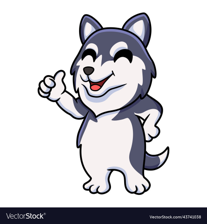

../images/dogs/husky/Image_44.jpg


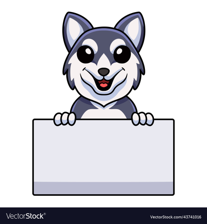

../images/dogs/husky/Image_45.jpg


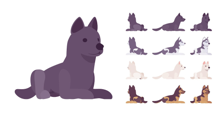

../images/dogs/husky/Image_46.jpg


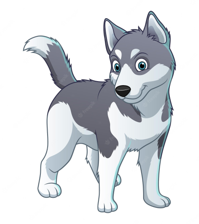

../images/dogs/husky/Image_47.jpg


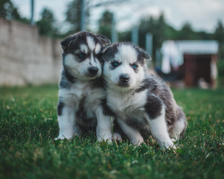

../images/dogs/husky/Image_48.jpg


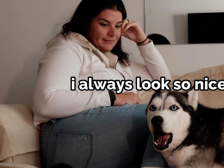

../images/dogs/husky/Image_49.jpg


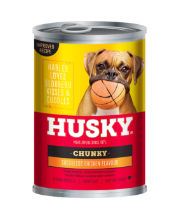

../images/dogs/husky/Image_50.jpg


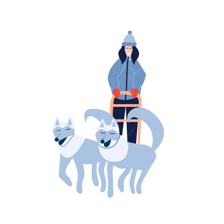

../images/dogs/husky/Image_51.jpg


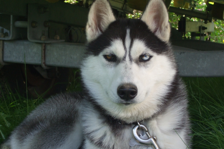

../images/dogs/husky/Image_52.jpg


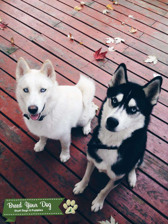

../images/dogs/husky/Image_53.jpg


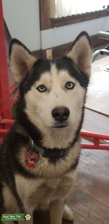

../images/dogs/husky/Image_54.jpg


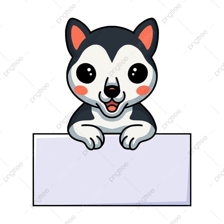

../images/dogs/husky/Image_55.png


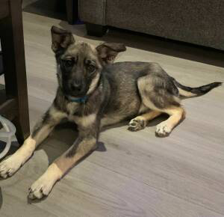

../images/dogs/husky/Image_56.jpeg


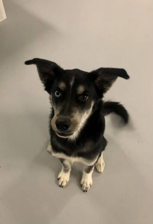

../images/dogs/husky/Image_57.jpeg


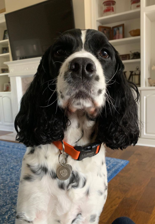

../images/dogs/husky/Image_58.jpg


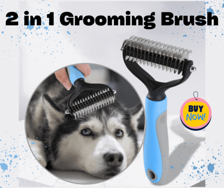

../images/dogs/husky/Image_59.png


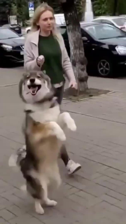

../images/dogs/husky/Image_60.jpg


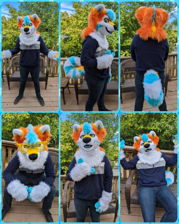

../images/dogs/husky/Image_61.jpg


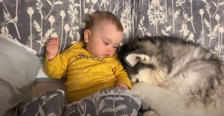

../images/dogs/husky/Image_62.jpg


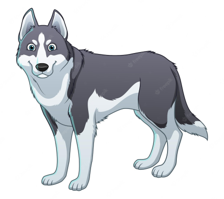

../images/dogs/husky/Image_63.jpg


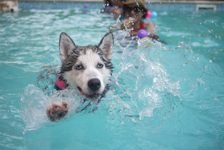

../images/dogs/husky/Image_64.jpg


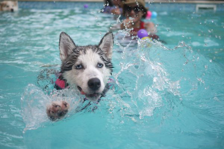

../images/dogs/husky/Image_65.jpg


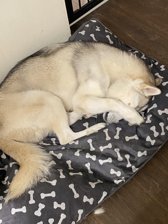

../images/dogs/husky/Image_66.jpg


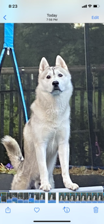

../images/dogs/husky/Image_67.jpg


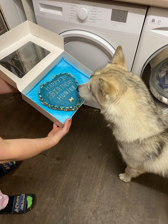

../images/dogs/husky/Image_68.jpg


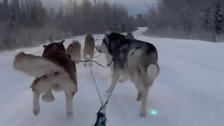

../images/dogs/husky/Image_69.jpg


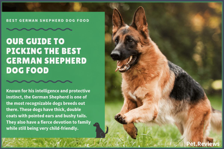

../images/dogs/husky/Image_70.jpg


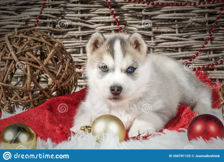

../images/dogs/husky/Image_71.jpg


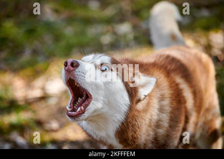

../images/dogs/husky/Image_72.jpg


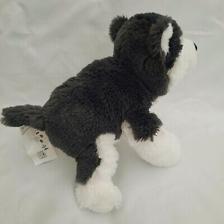

../images/dogs/husky/Image_73.jpg


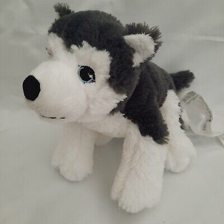

../images/dogs/husky/Image_74.jpg


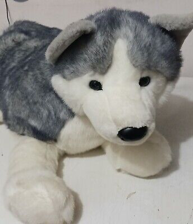

../images/dogs/husky/Image_75.jpg


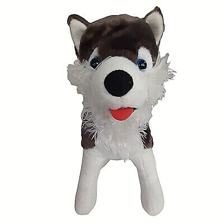

../images/dogs/husky/Image_76.jpg


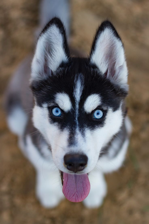

../images/dogs/husky/Image_77.jpg


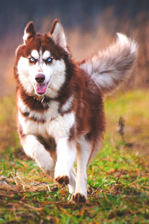

../images/dogs/husky/Image_78.jpg


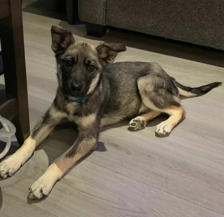

../images/dogs/husky/Image_79.jpeg


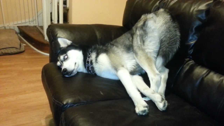

../images/dogs/husky/Image_80.jpg


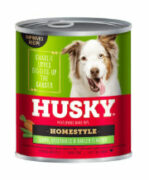

../images/dogs/husky/Image_81.jpg


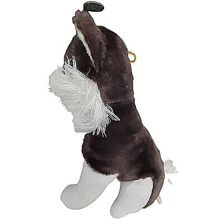

../images/dogs/husky/Image_82.jpg


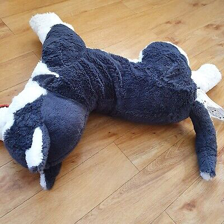

../images/dogs/husky/Image_83.jpg


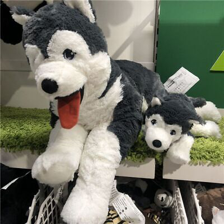

../images/dogs/husky/Image_84.jpg


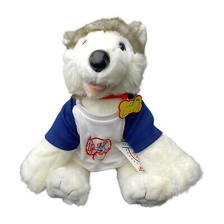

../images/dogs/husky/Image_85.jpg


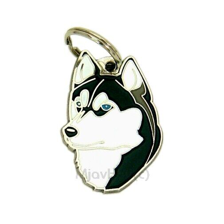

../images/dogs/husky/Image_86.jpg


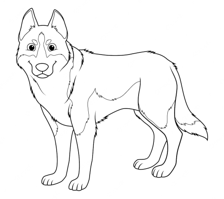

../images/dogs/husky/Image_87.jpg


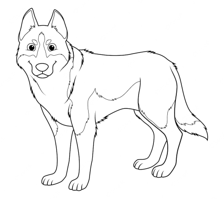

../images/dogs/husky/Image_88.jpg


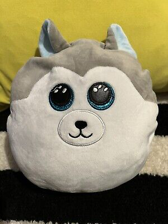

../images/dogs/husky/Image_89.jpg


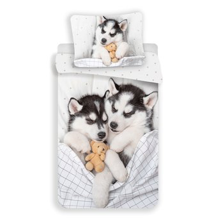

../images/dogs/husky/Image_90.jpg


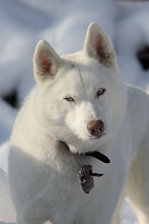

../images/dogs/husky/Image_91.jpg


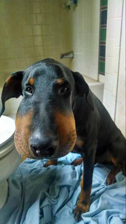

../images/dogs/husky/Image_92.jpg


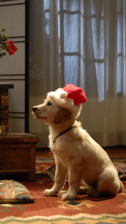

../images/dogs/husky/Image_93.jpg


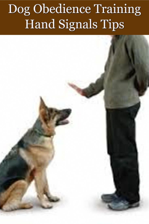

../images/dogs/husky/Image_94.jpg


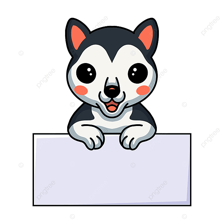

../images/dogs/husky/Image_95.png


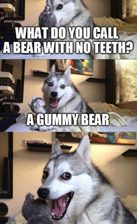

../images/dogs/husky/Image_96.jpg


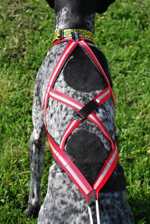

../images/dogs/husky/Image_97.jpg


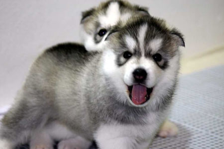

../images/dogs/husky/Image_98.jpg


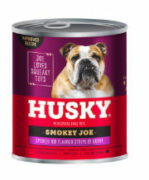

../images/dogs/husky/Image_99.jpg


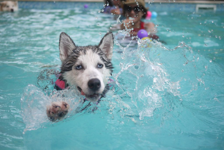

../images/dogs/husky/Image_100.jpg


In [55]:
husky = get_image_files(Path(f'{path}/husky'))

for dog in husky:
    print("=======")
    PILImage.create(dog).to_thumb(h=224).show()
    print(dog)
    print("=======")